<a href="https://colab.research.google.com/github/Hanief00/PCVK_GANJIL_2024/blob/main/Modul_5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Tugas Praktikum 1

Mounted at /content/drive
 Gamma Correction pada citra 
----------------------------------
Masukkan nilai Gamma: 3


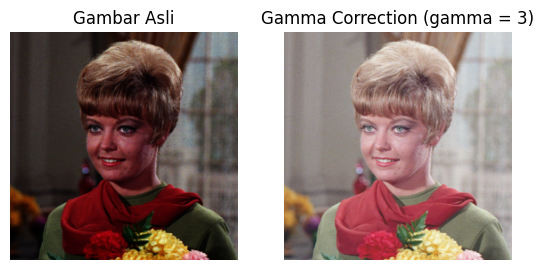

In [ ]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
from google.colab import drive

drive.mount('/content/drive')

original = cv.imread('/content/drive/MyDrive/Semester 5/Pengolahan Citra dan Visi Komputer/Modul_3/female.tiff', cv.IMREAD_COLOR)
image_rgb = cv.cvtColor(original, cv.COLOR_BGR2RGB)

def gamma_correction(image_path, gamma):
    # Membaca gambar sebagai array piksel
    image = image_rgb
    pixels = image.flatten()

    # Menerapkan rumus koreksi gamma untuk setiap piksel
    corrected_pixels = np.array([int(255 * ((pixel / 255) ** (1 / gamma))) for pixel in pixels], dtype=np.uint8)

    corrected_image = corrected_pixels.reshape(image.shape)
    return corrected_image

print(' Gamma Correction pada citra ')
print('----------------------------------')
try:
  gamma = int(input('Masukkan nilai Gamma: '))

  if original is None:
    print("Gambar tidak ditemukan!")
  else:

    # Terapkan gamma correction
    corrected_image = gamma_correction(image_rgb, gamma)

    # Simpan hasil gambar yang sudah dikoreksi
    cv.imwrite('corrected_image.jpg', corrected_image)

  # Menampilkan gambar asli, setelah gamma correction
  plt.figure(figsize=(10,5))

  # Gambar asli
  plt.subplot(1, 3, 1)
  plt.imshow(image_rgb, cmap='gray')
  plt.title('Gambar Asli')
  plt.axis('off')

  # Gambar gamma correction
  plt.subplot(1, 3, 2)
  plt.imshow(corrected_image, cmap='gray')
  plt.title(f'Gamma Correction (gamma = {gamma})')
  plt.axis('off')

  # Tampilkan semua gambar
  plt.show()

except ValueError:
    print('Error, not a number')

# Tugas Praktikum 2

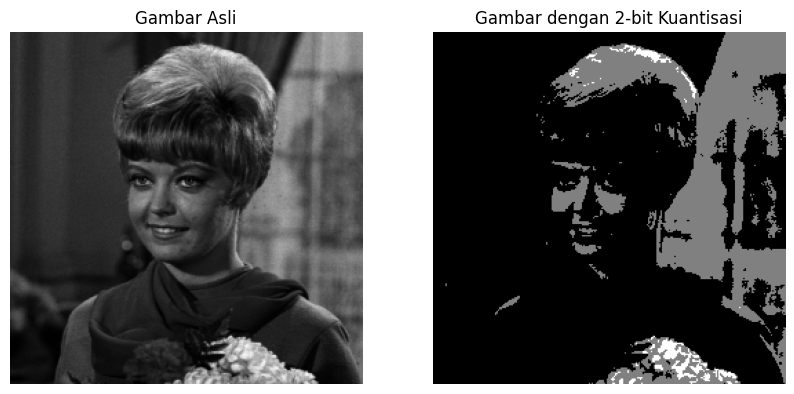

In [ ]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

def quantize_image(image_path, bit_depth):
    # Membaca gambar dalam mode grayscale
    original = cv.cvtColor(image_path, cv.COLOR_RGB2GRAY)

    # Menghitung level kuantisasi
    levels = 255 / (pow(2, bit_depth) - 1)

    # Melakukan kuantisasi
    quantized_image = np.floor(original / levels) * levels

    return original, quantized_image

# Contoh penggunaan
image_path = image_rgb
bit_depth = 2
original, quantized_image = quantize_image(image_path, bit_depth)

# Menampilkan gambar asli dan gambar yang telah dikuantisasi
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.title('Gambar Asli')
plt.imshow(original, cmap='gray')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title(f'Gambar dengan {bit_depth}-bit Kuantisasi')
plt.imshow(quantized_image, cmap='gray')
plt.axis('off')

plt.show()


# Tugas Praktikum 3

In [ ]:
import cv2 as cv
import numpy as np
import glob
import os

# Path untuk gambar asli
original_image_path = '/content/drive/MyDrive/Semester 5/Pengolahan Citra dan Visi Komputer/Modul_5/galaxy.png'

# Path untuk menyimpan gambar dengan Gaussian Noise
output_folder = '/content/drive/MyDrive/Semester 5/Pengolahan Citra dan Visi Komputer/Modul_5/noises/'

# Baca gambar asli
img = cv.imread(original_image_path, cv.IMREAD_COLOR)

# Buat folder jika belum ada
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Fungsi untuk menambahkan Gaussian Noise
def add_gaussian_noise(image, mean=0, sigma=25):
    row, col, ch = image.shape
    gauss = np.random.normal(mean, sigma, (row, col, ch))
    noisy = image + gauss.reshape(row, col, ch)
    noisy = np.clip(noisy, 0, 255).astype(np.uint8)
    return noisy

# Membuat 100 gambar dengan Gaussian Noise
for i in range(100):
    noisy_image = add_gaussian_noise(img)
    output_path = os.path.join(output_folder, f'noisy_image_{i+1}.png')
    cv.imwrite(output_path, noisy_image)

print("100 gambar dengan Gaussian Noise telah berhasil disimpan.")


100 gambar dengan Gaussian Noise telah berhasil disimpan.


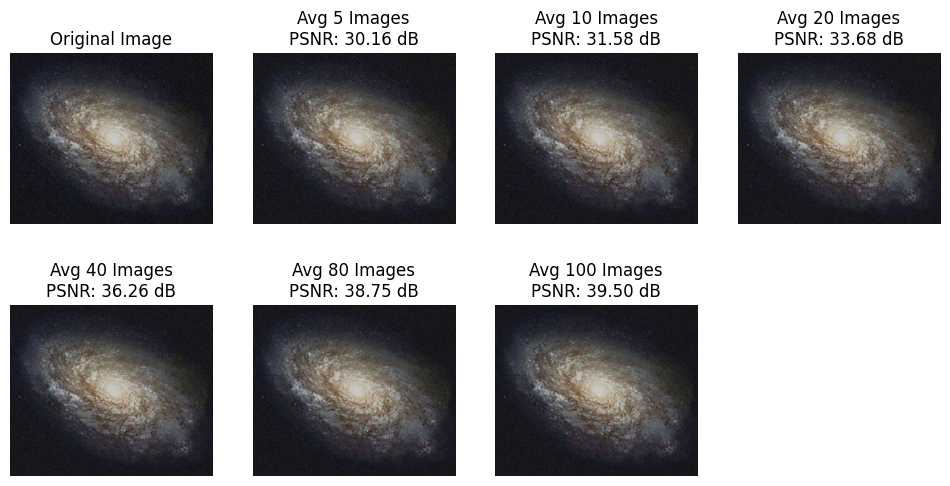

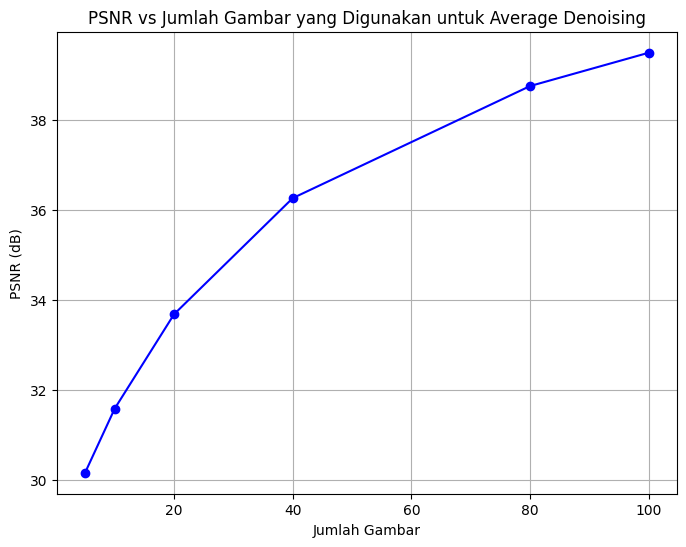

In [ ]:
import cv2 as cv
import numpy as np
import glob
import os

import matplotlib.pyplot as plt

# Fungsi untuk menghitung PSNR
def calculate_psnr(original, denoised):
    mse = np.mean((original - denoised) ** 2)
    if mse == 0:
        return float('inf')
    max_pixel = 255.0
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

# Fungsi untuk melakukan average denoising
def average_denoising(image_list):
    average_image = np.zeros_like(image_list[0], dtype=np.float64)
    for img in image_list:
        average_image += img.astype(np.float64)
    average_image /= len(image_list)
    return np.clip(average_image, 0, 255).astype(np.uint8)

original_image_path = '/content/drive/MyDrive/Semester 5/Pengolahan Citra dan Visi Komputer/Modul_5/galaxy.png'
original_image = cv.imread(original_image_path, cv.IMREAD_COLOR)

# Convert gambar BGR ke RGB
original_image_rgb = cv.cvtColor(original_image, cv.COLOR_BGR2RGB)

noisy_images_path = '/content/drive/MyDrive/Semester 5/Pengolahan Citra dan Visi Komputer/Modul_5/noises/*.png'
noisy_images = sorted(glob.glob(noisy_images_path))

# Jumlah citra yang akan diuji
num_images_list = [5, 10, 20, 40, 80, 100]
psnr_values = []

# Plot gambar asli
plt.figure(figsize=(12, 6))
plt.subplot(2, 4, 1)
plt.imshow(original_image_rgb)
plt.title('Original Image')
plt.axis('off')

# Loop untuk melakukan average denoising dan menghitung PSNR
for idx, num_images in enumerate(num_images_list):
    # Mengambil gambar
    selected_images = [cv.imread(img) for img in noisy_images[:num_images]]

    # Terapkan average denoising
    denoised_image = average_denoising(selected_images)

    # Hitung PSNR
    psnr_value = calculate_psnr(original_image, denoised_image)
    psnr_values.append(psnr_value)

    # Convert gambar yang telah di denoising BGR ke RGB
    denoised_image_rgb = cv.cvtColor(denoised_image, cv.COLOR_BGR2RGB)

    plt.subplot(2, 4, idx+2)
    plt.imshow(denoised_image_rgb)
    plt.title(f'Avg {num_images} Images\nPSNR: {psnr_value:.2f} dB')
    plt.axis('off')

# Plot PSNR vs Jumlah Gambar
plt.figure(figsize=(8, 6))
plt.plot(num_images_list, psnr_values, marker='o', linestyle='-', color='b')
plt.title('PSNR vs Jumlah Gambar yang Digunakan untuk Average Denoising')
plt.xlabel('Jumlah Gambar')
plt.ylabel('PSNR (dB)')
plt.grid(True)
plt.show()


* KESIMPULAN

Metode average denoising efektif untuk mengurangi gaussian noise pada citra gambar dengan menggunakan 40-80 gambar, dan nilai PSNR menjadi indikator utama untuk mengukur keberhasilan denoising.

# Tugas Praktikum 4

Hasil operasi OR


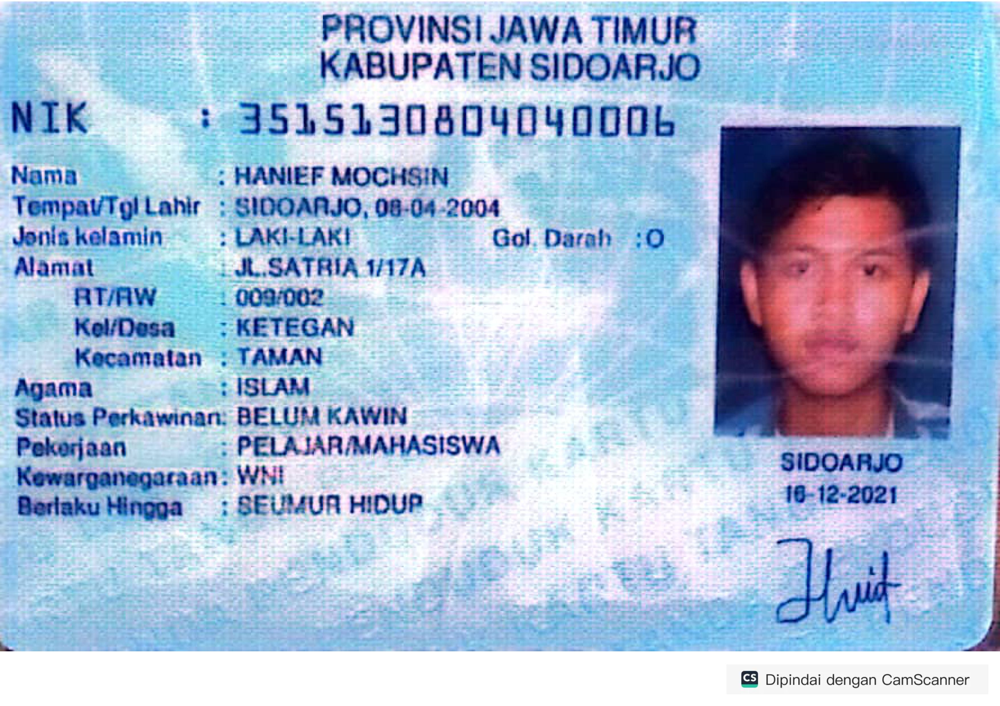

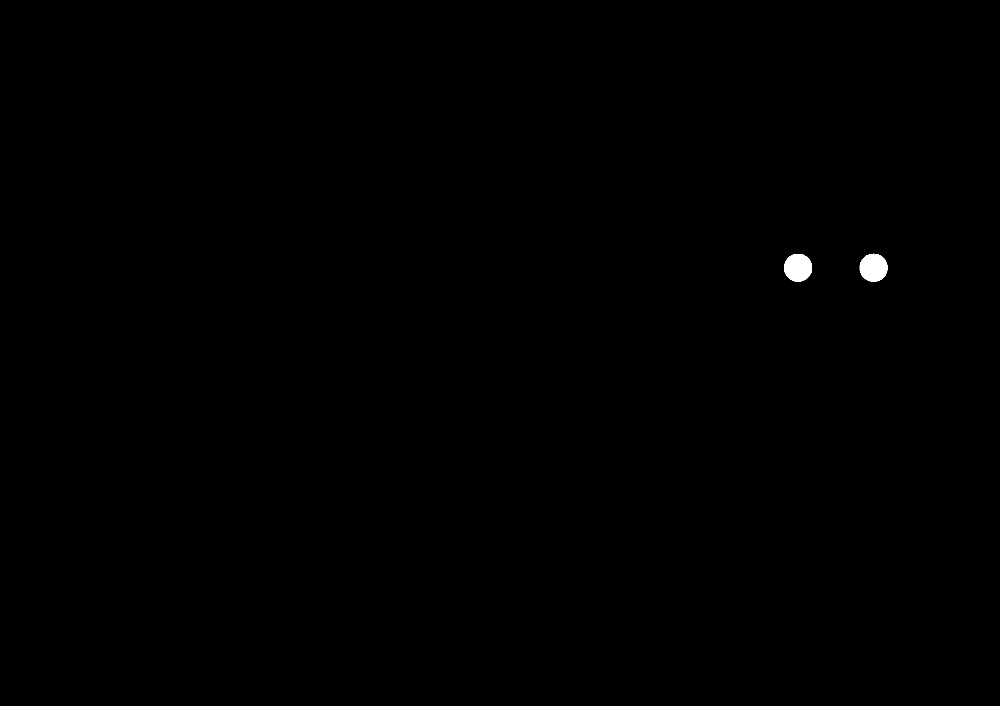

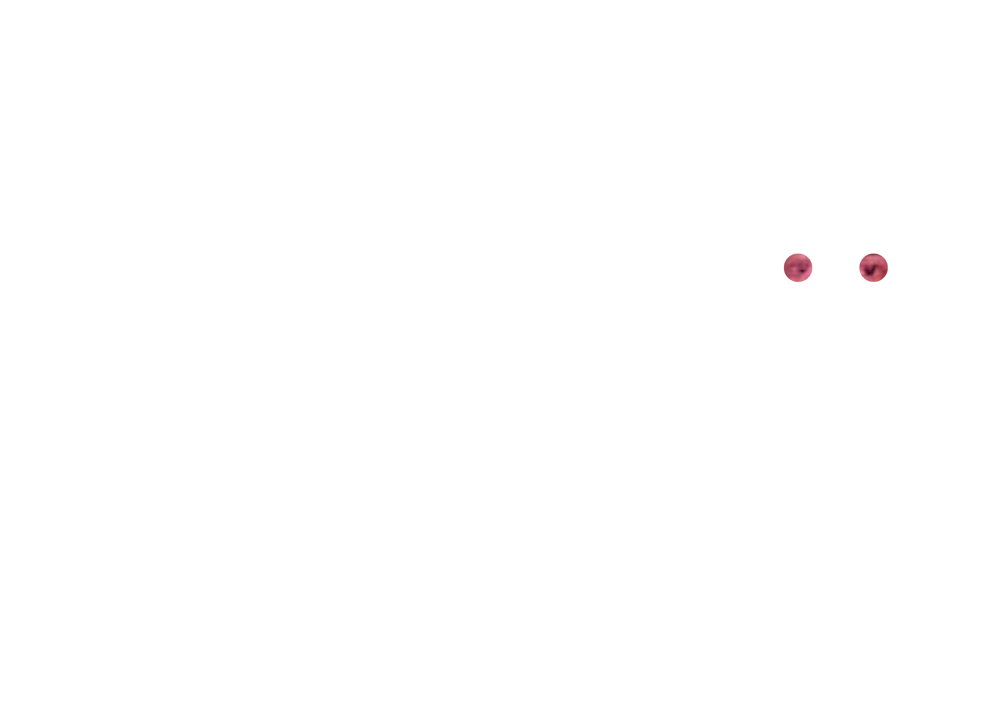

In [13]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Load gambar KTP
image = cv2.imread('/content/drive/MyDrive/Semester 5/Pengolahan Citra dan Visi Komputer/Modul_5/KTP hanif.jpg')

# Buat masker hitam seukuran gambar
mask = np.zeros(image.shape[:2], dtype="uint8")

# Posisi dan ukuran lingkaran
center1 = (2800, 940)
radius1 = 50

center2 = (3065, 940)
radius2 = 50

# Gambar lingkaran putih di area yang ditentukan pada masker
cv2.circle(mask, center1, radius1, 255, -1)
cv2.circle(mask, center2, radius2, 255, -1)

# Terapkan masking pada gambar asli
masked_image = cv2.bitwise_and(image, image, mask=mask)

# Buat background putih
background_white = np.ones_like(image) * 255

# Buat mask inverse (area di luar lingkaran menjadi 255)
mask_inv = cv2.bitwise_not(mask)

# Gabungkan background hitam dengan gambar yang telah dimasking, hanya di area lingkaran
background_white = np.ones_like(image) * 255
masked_image_or = cv2.bitwise_or(background_white, image, mask=mask)

# Gabungkan background putih dengan gambar yang telah dimasking, hanya di area lingkaran
final_image_white = background_white.copy()
final_image_white[mask == 255] = masked_image[mask == 255]

# Tampilkan 3 gambar
cv2_imshow(image)
cv2_imshow(masked_image_or)
cv2_imshow(final_image_white)

cv2.waitKey(0)
cv2.destroyAllWindows()

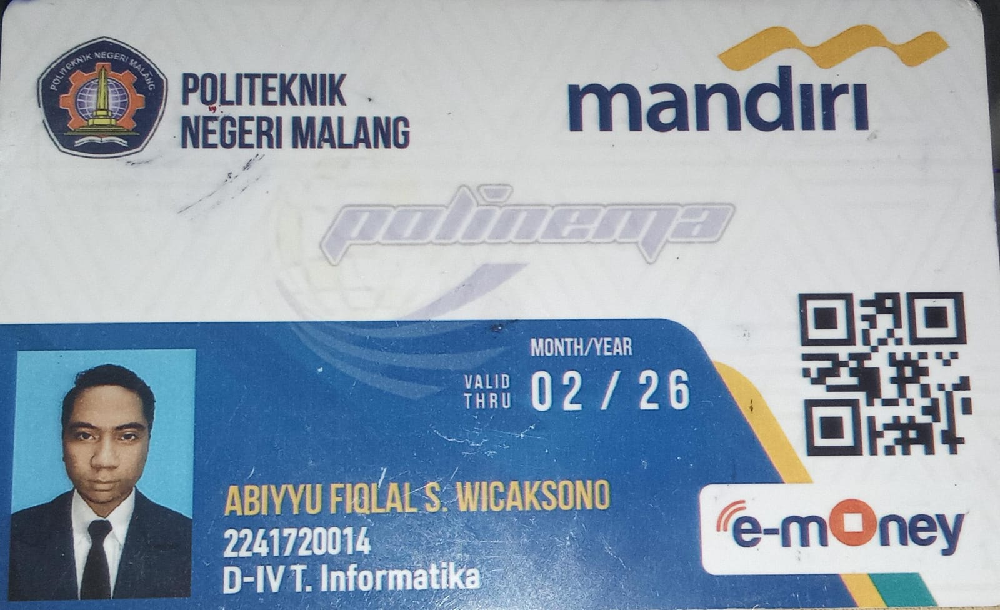

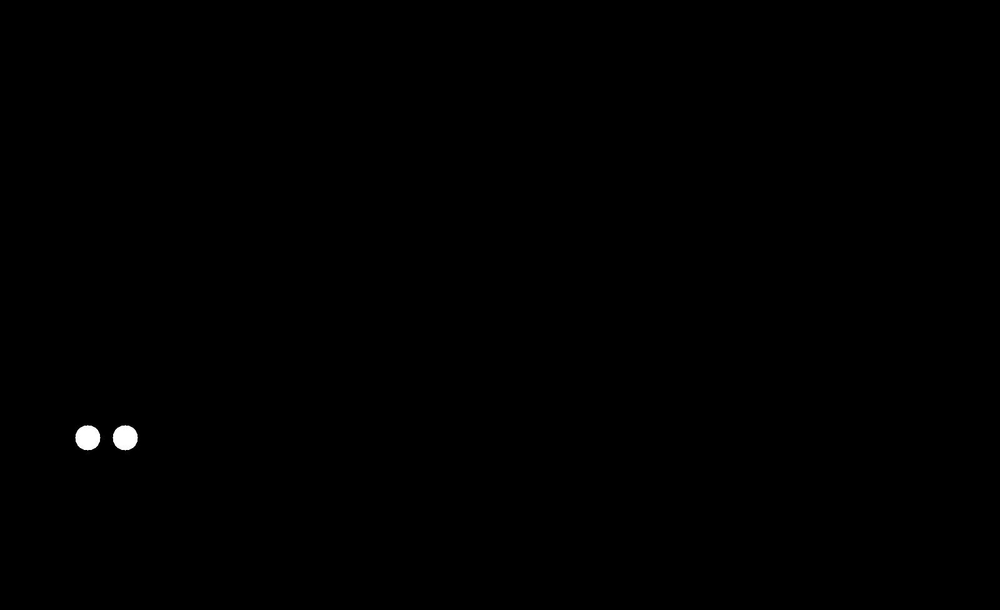

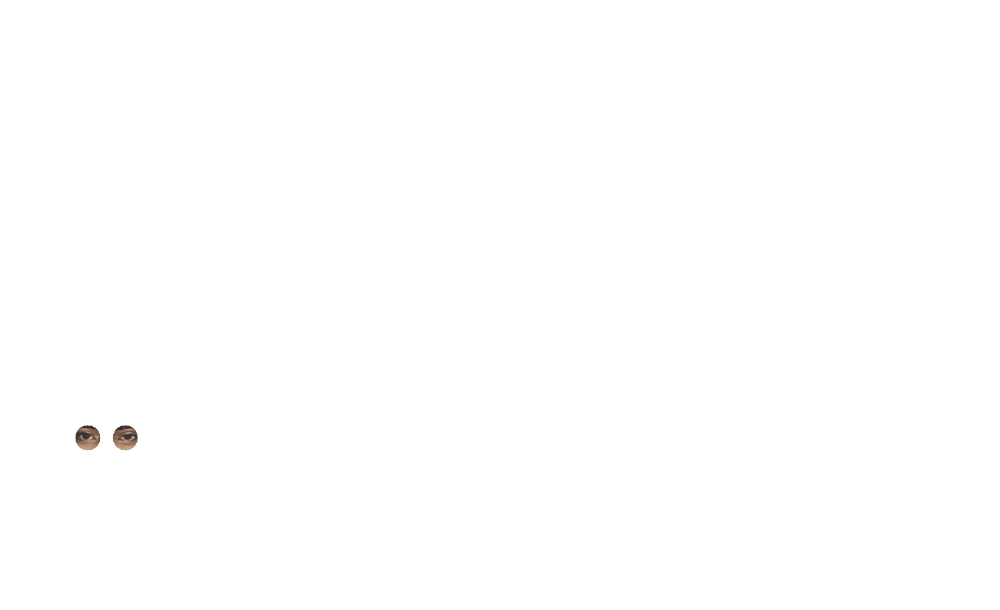

In [22]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Load gambar KTP
image = cv2.imread('/content/drive/MyDrive/Semester 5/Pengolahan Citra dan Visi Komputer/Fiqlal.jpeg')

# Buat masker hitam seukuran gambar
mask = np.zeros(image.shape[:2], dtype="uint8")

# Posisi dan ukuran lingkaran
center1 = (140, 700)
radius1 = 20

center2 = (200, 700)
radius2 = 20

# Gambar lingkaran putih di area yang ditentukan pada masker
cv2.circle(mask, center1, radius1, 255, -1)
cv2.circle(mask, center2, radius2, 255, -1)

# Terapkan masking pada gambar asli
masked_image = cv2.bitwise_and(image, image, mask=mask)

# Buat background putih
background_white = np.ones_like(image) * 255

# Buat mask inverse (area di luar lingkaran menjadi 255)
mask_inv = cv2.bitwise_not(mask)

# Gabungkan background hitam dengan gambar yang telah dimasking, hanya di area lingkaran
background_white = np.ones_like(image) * 255
masked_image_or = cv2.bitwise_or(background_white, image, mask=mask)

# Gabungkan background putih dengan gambar yang telah dimasking, hanya di area lingkaran
final_image_white = background_white.copy()
final_image_white[mask == 255] = masked_image[mask == 255]

# Tampilkan 3 gambar
cv2_imshow(image)
cv2_imshow(masked_image_or)
cv2_imshow(final_image_white)

cv2.waitKey(0)
cv2.destroyAllWindows()

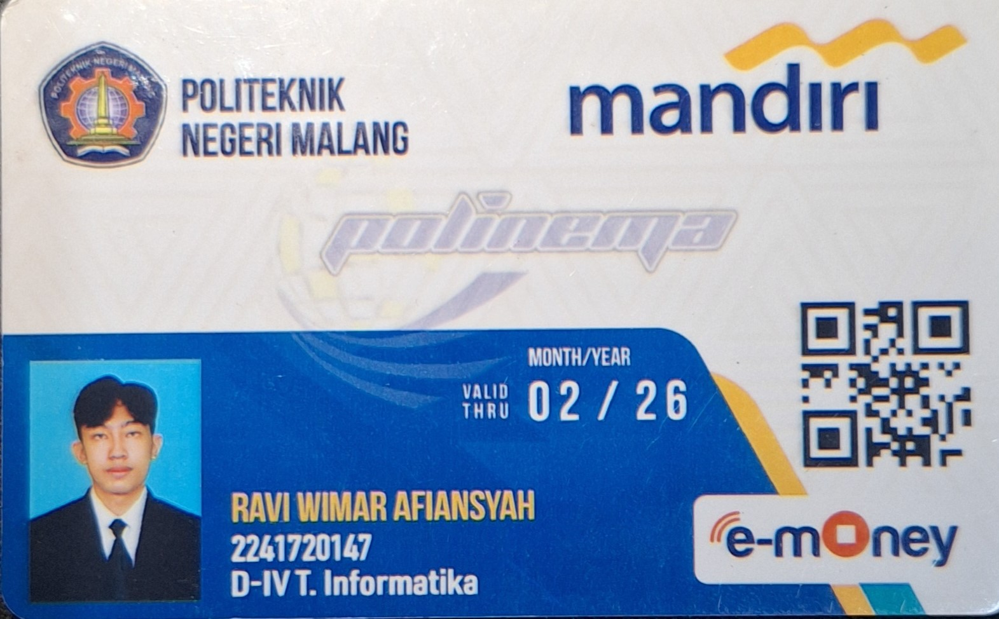

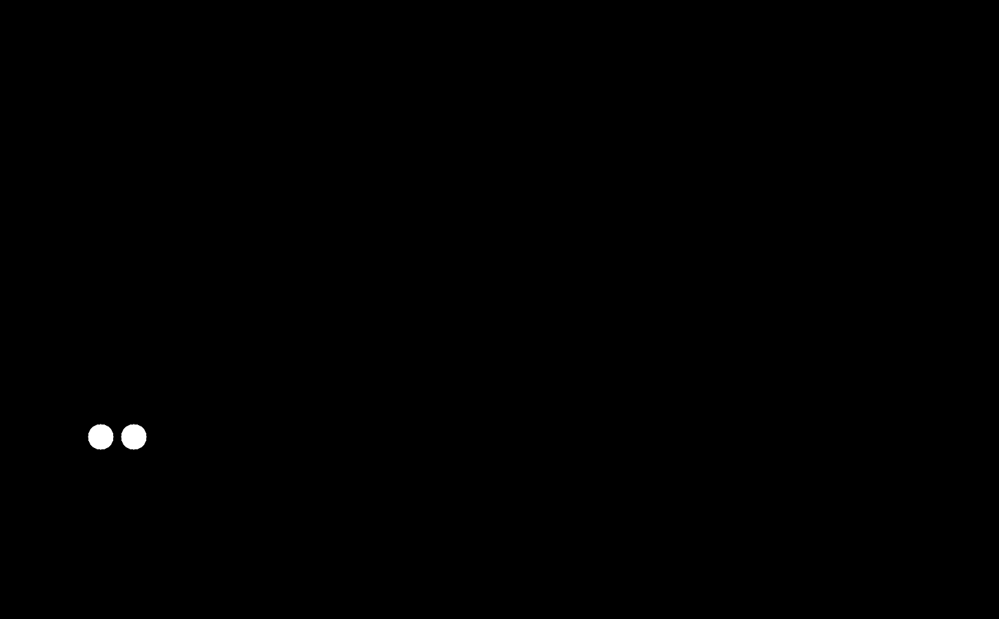

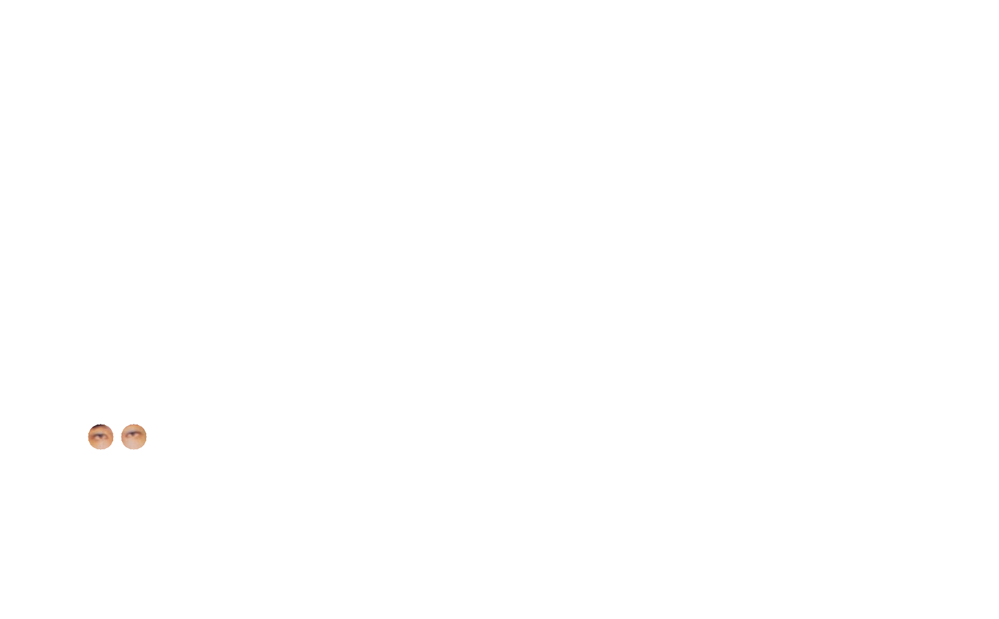

In [27]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Load gambar KTP
image = cv2.imread('/content/drive/MyDrive/Semester 5/Pengolahan Citra dan Visi Komputer/Ravi.jpeg')

# Buat masker hitam seukuran gambar
mask = np.zeros(image.shape[:2], dtype="uint8")

# Posisi dan ukuran lingkaran
center1 = (158, 687)
radius1 = 20

center2 = (210, 687)
radius2 = 20

# Gambar lingkaran putih di area yang ditentukan pada masker
cv2.circle(mask, center1, radius1, 255, -1)
cv2.circle(mask, center2, radius2, 255, -1)

# Terapkan masking pada gambar asli
masked_image = cv2.bitwise_and(image, image, mask=mask)

# Buat background putih
background_white = np.ones_like(image) * 255

# Buat mask inverse (area di luar lingkaran menjadi 255)
mask_inv = cv2.bitwise_not(mask)

# Gabungkan background hitam dengan gambar yang telah dimasking, hanya di area lingkaran
background_white = np.ones_like(image) * 255
masked_image_or = cv2.bitwise_or(background_white, image, mask=mask)

# Gabungkan background putih dengan gambar yang telah dimasking, hanya di area lingkaran
final_image_white = background_white.copy()
final_image_white[mask == 255] = masked_image[mask == 255]

# Tampilkan 3 gambar
cv2_imshow(image)
cv2_imshow(masked_image_or)
cv2_imshow(final_image_white)

cv2.waitKey(0)
cv2.destroyAllWindows()

# Tugas Praktikum 5

Hasil operasi NOT


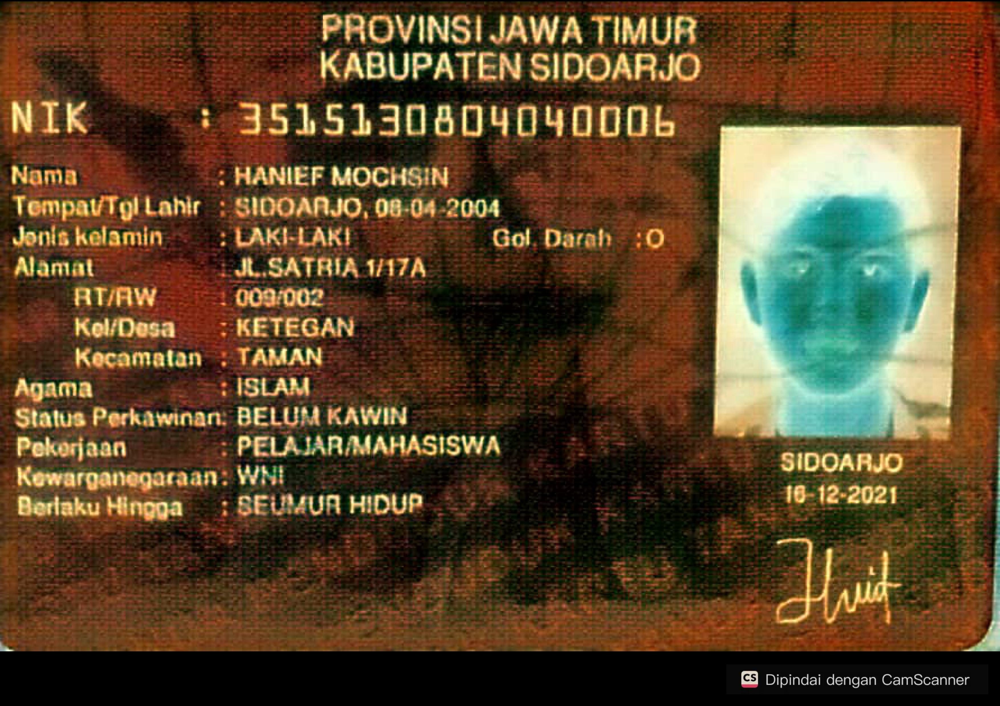

Hasil operasi AND


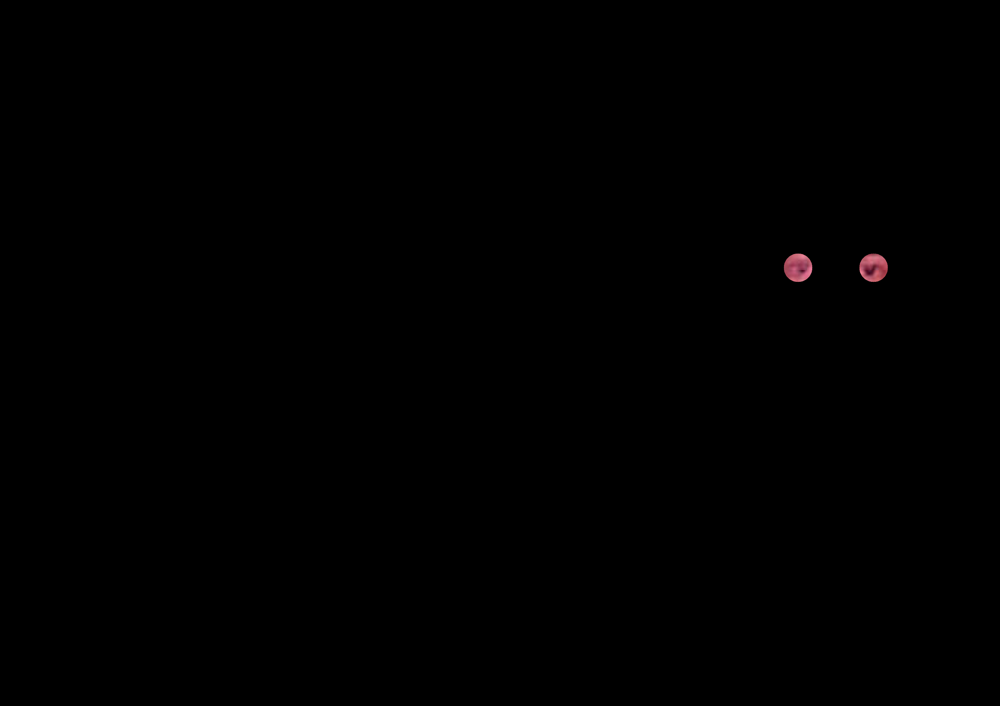

Hasil operasi OR


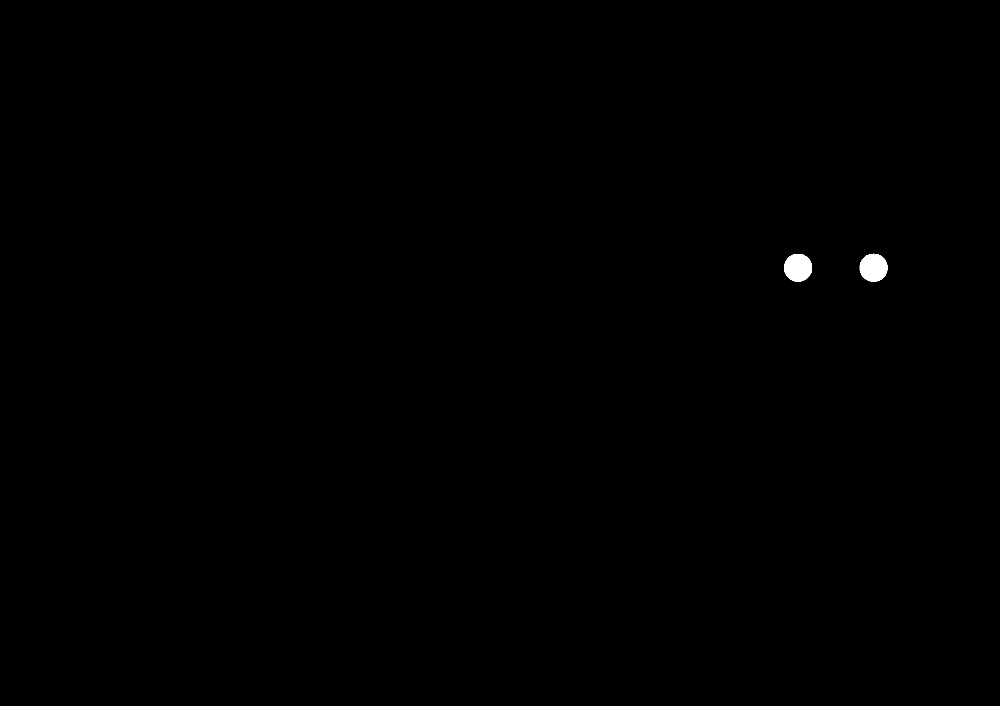

Hasil operasi NAND


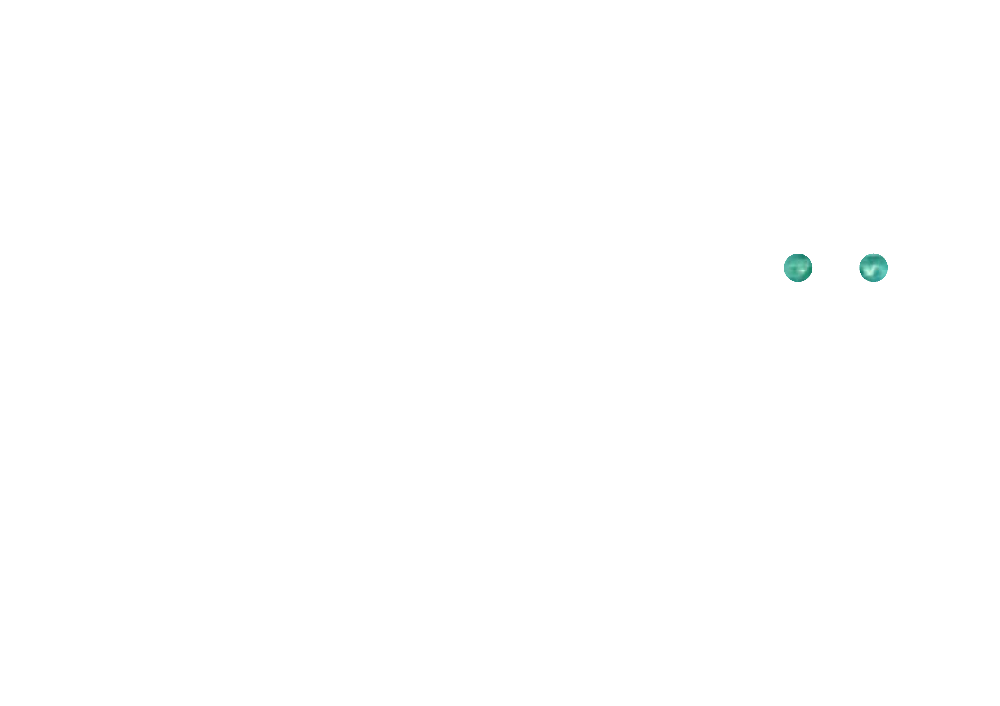

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Load gambar KTP
image = cv2.imread('/content/drive/MyDrive/Semester 5/Pengolahan Citra dan Visi Komputer/Modul_5/KTP hanif.jpg')

# Buat masker hitam seukuran gambar
mask = np.zeros(image.shape[:2], dtype="uint8")

# Tentukan posisi dan ukuran lingkaran secara manual
center1 = (2800, 940)
radius1 = 50

center2 = (3065, 940)
radius2 = 50

# Gambar lingkaran putih di area yang ditentukan pada masker
cv2.circle(mask, center1, radius1, 255, -1)
cv2.circle(mask, center2, radius2, 255, -1)

# 1. NOT Operation
print("Hasil operasi NOT")
not_image = cv2.bitwise_not(image)  # Meng-inverse seluruh warna gambar
cv2_imshow(not_image)  # Tampilkan hasil operasi NOT

# 2. AND Operation
print("Hasil operasi AND")
masked_image_and = cv2.bitwise_and(image, image, mask=mask)  # Hanya bagian lingkaran yang ditampilkan
cv2_imshow(masked_image_and)  # Tampilkan hasil operasi AND

# 3. OR Operation
print("Hasil operasi OR")
background_white = np.ones_like(image) * 255  # Buat background putih
masked_image_or = cv2.bitwise_or(background_white, image, mask=mask)  # Bagian lingkaran yang ditampilkan
cv2_imshow(masked_image_or)  # Tampilkan hasil operasi OR

# 4. NAND Operation (NAND = NOT(AND))
print("Hasil operasi NAND")
masked_image_nand = cv2.bitwise_not(cv2.bitwise_and(image, image, mask=mask))  # Meng-inverse hasil AND (NAND)
cv2_imshow(masked_image_nand)  # Tampilkan hasil operasi NAND

cv2.waitKey(0)
cv2.destroyAllWindows()


* NOT mengubah keseluruhan warna citra dengan membalikkan setiap pikselnya.
* AND menampilkan hanya area yang diizinkan oleh mask, dalam hal ini area lingkaran mata saja yang muncul.
* OR menggabungkan citra dengan background putih, dengan hanya menampilkan lingkaran dari gambar asli dan mengisi area lainnya dengan putih.
* NAND adalah kebalikan dari AND, area di luar lingkaran mata tetap dari gambar asli, sementara area dalam lingkaran dihitamkan.